In [1]:
from tqdm import tqdm
import os
import time
from random import randint

import numpy as np
from scipy import stats
import pandas as pd

from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedKFold
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVR
from sklearn.model_selection import KFold

import nibabel as nib
import pydicom as pdm
import nilearn as nl
import nilearn.plotting as nlplt
import h5py

import matplotlib.pyplot as plt
from matplotlib import cm
import matplotlib.animation as anim
import matplotlib.patches as mpatches
import matplotlib.gridspec as gridspec

import seaborn as sns
import imageio
from skimage.transform import resize
from skimage.util import montage

from IPython.display import Image as show_gif
from IPython.display import clear_output
from IPython.display import YouTubeVideo

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torch.nn.functional as F

from torch.optim import Adam
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.nn import MSELoss


import albumentations as A
from albumentations import Compose, HorizontalFlip
from albumentations.pytorch import ToTensorV2 

import warnings
warnings.simplefilter("ignore")

In [2]:
torch.cuda.empty_cache()

In [64]:
PROJ_ROOT = os.path.join(os.path.abspath(os.pardir),'brats_lf')
PROJ_ROOT

'/home/luis-felipe/brats_lf'

In [4]:
sample_filename = os.path.join(PROJ_ROOT,'MICCAI_BraTS2020_TrainingData','BraTS20_Training_001','BraTS20_Training_001_flair.nii.gz')
sample_filename_mask = os.path.join(PROJ_ROOT,'MICCAI_BraTS2020_TrainingData','BraTS20_Training_001','BraTS20_Training_001_seg.nii.gz')

sample_img = nib.load(sample_filename)
sample_img = np.asanyarray(sample_img.dataobj)
sample_img = np.rot90(sample_img)
sample_mask = nib.load(sample_filename_mask)
sample_mask = np.asanyarray(sample_mask.dataobj)
sample_mask = np.rot90(sample_mask)
print("img shape ->", sample_img.shape)
print("mask shape ->", sample_mask.shape)


img shape -> (240, 240, 155)
mask shape -> (240, 240, 155)


In [5]:
sample_filename2 = os.path.join(PROJ_ROOT,'MICCAI_BraTS2020_TrainingData','BraTS20_Training_001','BraTS20_Training_001_t1.nii.gz')
sample_img2 = nib.load(sample_filename2)
sample_img2 = np.asanyarray(sample_img2.dataobj)
sample_img2  = np.rot90(sample_img2)

sample_filename3 = os.path.join(PROJ_ROOT,'MICCAI_BraTS2020_TrainingData','BraTS20_Training_001','BraTS20_Training_001_t2.nii.gz')

sample_img3 = nib.load(sample_filename3)
sample_img3 = np.asanyarray(sample_img3.dataobj)
sample_img3  = np.rot90(sample_img3)

sample_filename4 = os.path.join(PROJ_ROOT,'MICCAI_BraTS2020_TrainingData','BraTS20_Training_001','BraTS20_Training_001_t1ce.nii.gz')
sample_img4 = nib.load(sample_filename4)
sample_img4 = np.asanyarray(sample_img4.dataobj)
sample_img4  = np.rot90(sample_img4)

mask_WT = sample_mask.copy()
mask_WT[mask_WT == 1] = 1
mask_WT[mask_WT == 2] = 1
mask_WT[mask_WT == 4] = 1

mask_TC = sample_mask.copy()
mask_TC[mask_TC == 1] = 1
mask_TC[mask_TC == 2] = 0
mask_TC[mask_TC == 4] = 1

mask_ET = sample_mask.copy()
mask_ET[mask_ET == 1] = 0
mask_ET[mask_ET == 2] = 0
mask_ET[mask_ET == 4] = 1

### What's the data looks like ?

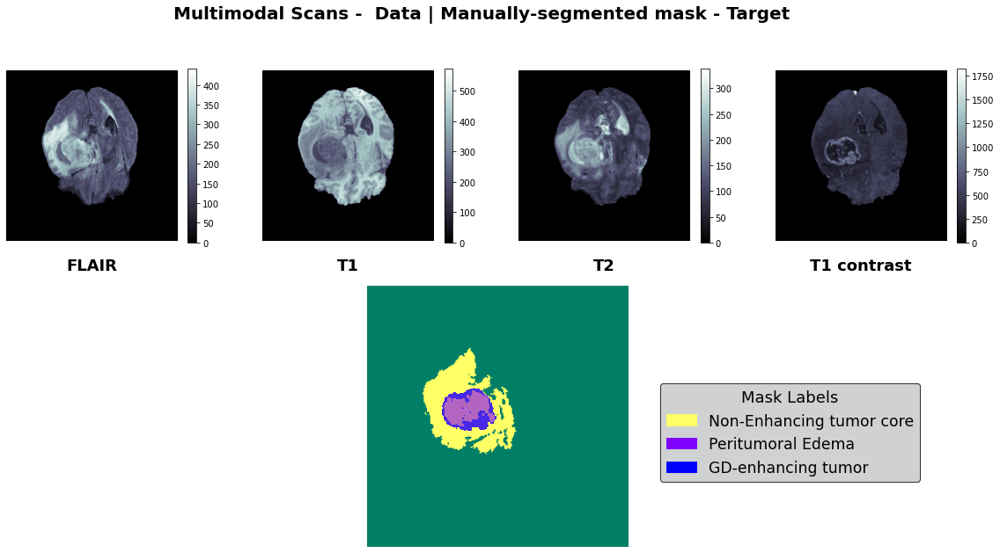

In [6]:

fig = plt.figure(figsize=(20, 10))

gs = gridspec.GridSpec(nrows=2, ncols=4, height_ratios=[1, 1.5])

#  Varying density along a streamline
ax0 = fig.add_subplot(gs[0, 0])
flair = ax0.imshow(sample_img[:,:,65], cmap='bone')
ax0.set_title("FLAIR", fontsize=18, weight='bold', y=-0.2)
fig.colorbar(flair)

#  Varying density along a streamline
ax1 = fig.add_subplot(gs[0, 1])
t1 = ax1.imshow(sample_img2[:,:,65], cmap='bone')
ax1.set_title("T1", fontsize=18, weight='bold', y=-0.2)
fig.colorbar(t1)

#  Varying density along a streamline
ax2 = fig.add_subplot(gs[0, 2])
t2 = ax2.imshow(sample_img3[:,:,65], cmap='bone')
ax2.set_title("T2", fontsize=18, weight='bold', y=-0.2)
fig.colorbar(t2)

#  Varying density along a streamline
ax3 = fig.add_subplot(gs[0, 3])
t1ce = ax3.imshow(sample_img4[:,:,65], cmap='bone')
ax3.set_title("T1 contrast", fontsize=18, weight='bold', y=-0.2)
fig.colorbar(t1ce)

#  Varying density along a streamline
ax4 = fig.add_subplot(gs[1, 1:3])

#ax4.imshow(np.ma.masked_where(mask_WT[:,:,65]== False,  mask_WT[:,:,65]), cmap='summer', alpha=0.6)
l1 = ax4.imshow(mask_WT[:,:,65], cmap='summer',)
l2 = ax4.imshow(np.ma.masked_where(mask_TC[:,:,65]== False,  mask_TC[:,:,65]), cmap='rainbow', alpha=0.6)
l3 = ax4.imshow(np.ma.masked_where(mask_ET[:,:,65] == False, mask_ET[:,:,65]), cmap='winter', alpha=0.6)

ax4.set_title("", fontsize=20, weight='bold', y=-0.1)

_ = [ax.set_axis_off() for ax in [ax0,ax1,ax2,ax3, ax4]]

colors = [im.cmap(im.norm(1)) for im in [l1,l2, l3]]
labels = ['Non-Enhancing tumor core', 'Peritumoral Edema ', 'GD-enhancing tumor']
patches = [ mpatches.Patch(color=colors[i], label=f"{labels[i]}") for i in range(len(labels))]
# put those patched as legend-handles into the legend
plt.legend(handles=patches, bbox_to_anchor=(1.1, 0.65), loc=2, borderaxespad=0.4,fontsize = 'xx-large',
           title='Mask Labels', title_fontsize=18, edgecolor="black",  facecolor='#c5c6c7')

plt.suptitle("Multimodal Scans -  Data | Manually-segmented mask - Target", fontsize=20, weight='bold')

fig.savefig("data_sample.png", format="png",  pad_inches=0.2, transparent=False, bbox_inches='tight')
fig.savefig("data_sample.svg", format="svg",  pad_inches=0.2, transparent=False, bbox_inches='tight')

helper classes and functions

In [7]:


#csv_paths = get_all_csv_file("../input/brats20-dataset-training-validation/BraTS2020_TrainingData")

In [8]:
class GlobalConfig:
    
    root_dir = os.path.join(PROJ_ROOT,'data')
    train_root_dir =os.path.join(root_dir, 'BraTS2020_TrainingData','MICCAI_BraTS2020_TrainingData')
    test_root_dir = os.path.join(root_dir, 'BraTS2020_TrainingData','MICCAI_BraTS2020_ValidationData')
    path_to_csv = os.path.join(root_dir,'train_data.csv')
    pretrained_model_path = os.path.join(PROJ_ROOT,'brats2020logs','unet','last_epoch_model.pth')
    train_logs_path = os.path.join(PROJ_ROOT,'brats2020logs','unet','train_log.csv')
    ae_pretrained_model_path = os.path.join(PROJ_ROOT,'brats2020logs','ae','autoencoder_best_model.pth')
    tab_data = os.path.join(PROJ_ROOT,'brats2020logs','data','df_with_voxel_stats_and_latent_features.csv')
    seed = 55
    
def seed_everything(seed: int):
    np.random.seed(seed)
    torch.manual_seed(seed)
    if torch.cuda.is_available():
        torch.cuda.manual_seed(seed)
    
config = GlobalConfig()
seed_everything(config.seed)

Data Preprocessing

training process

In [18]:
nodel = UNet3d(in_channels=4, n_classes=3, n_channels=24).to(dev)

In [19]:
trainer = Trainer(net=nodel,
                  dataset=BratsDataset,
                  criterion=BCEDiceLoss(),
                  lr=5e-4,
                  accumulation_steps=4,
                  batch_size=1,
                  fold=0,
                  num_epochs=1,
                  path_to_csv = config.path_to_csv)

if config.pretrained_model_path is not None:
    trainer.load_predtrain_model(config.pretrained_model_path)
    
    # if need - load the logs.      
    train_logs = pd.read_csv(config.train_logs_path)
    trainer.losses["train"] =  train_logs.loc[:, "train_loss"].to_list()
    trainer.losses["val"] =  train_logs.loc[:, "val_loss"].to_list()
    trainer.dice_scores["train"] = train_logs.loc[:, "train_dice"].to_list()
    trainer.dice_scores["val"] = train_logs.loc[:, "val_dice"].to_list()
    trainer.jaccard_scores["train"] = train_logs.loc[:, "train_jaccard"].to_list()
    trainer.jaccard_scores["val"] = train_logs.loc[:, "val_jaccard"].to_list()

device: cuda
Predtrain model loaded


In [20]:
%%time
trainer.run()

train epoch: 0 | time: 01:43:13


FileNotFoundError: Caught FileNotFoundError in DataLoader worker process 0.
Original Traceback (most recent call last):
  File "/home/luis-felipe/anaconda3/lib/python3.8/site-packages/nibabel/loadsave.py", line 42, in load
    stat_result = os.stat(filename)
FileNotFoundError: [Errno 2] No such file or directory: '../input/brats20-dataset-training-validation/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_058/BraTS20_Training_058_flair.nii'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/home/luis-felipe/anaconda3/lib/python3.8/site-packages/torch/utils/data/_utils/worker.py", line 287, in _worker_loop
    data = fetcher.fetch(index)
  File "/home/luis-felipe/anaconda3/lib/python3.8/site-packages/torch/utils/data/_utils/fetch.py", line 49, in fetch
    data = [self.dataset[idx] for idx in possibly_batched_index]
  File "/home/luis-felipe/anaconda3/lib/python3.8/site-packages/torch/utils/data/_utils/fetch.py", line 49, in <listcomp>
    data = [self.dataset[idx] for idx in possibly_batched_index]
  File "<ipython-input-10-17c0f1585a83>", line 19, in __getitem__
    img = self.load_img(img_path)#.transpose(2, 0, 1)
  File "<ipython-input-10-17c0f1585a83>", line 58, in load_img
    data = nib.load(file_path)
  File "/home/luis-felipe/anaconda3/lib/python3.8/site-packages/nibabel/loadsave.py", line 44, in load
    raise FileNotFoundError(f"No such file or no access: '{filename}'")
FileNotFoundError: No such file or no access: '../input/brats20-dataset-training-validation/BraTS2020_TrainingData/MICCAI_BraTS2020_TrainingData/BraTS20_Training_058/BraTS20_Training_058_flair.nii'


# Experiments and Results

In [22]:
val_dataloader = get_dataloader(BratsDataset, 'train_data.csv', phase='valid', fold=0)
len(dataloader)

34

In [23]:
nodel.eval();

In [24]:
nodel = nodel.cpu()

In [25]:
for p in nodel.parameters():
    print(p.device)
    break

cpu


In [26]:
%%time
dice_scores_per_classes, iou_scores_per_classes = compute_scores_per_classes(
    nodel, val_dataloader, ['WT', 'TC', 'ET'])

CPU times: user 22min 39s, sys: 9min 32s, total: 32min 11s
Wall time: 5min 35s


In [ ]:
dice_df = pd.DataFrame(dice_scores_per_classes)
dice_df.columns = ['WT dice', 'TC dice', 'ET dice']

iou_df = pd.DataFrame(iou_scores_per_classes)
iou_df.columns = ['WT jaccard', 'TC jaccard', 'ET jaccard']
val_metics_df = pd.concat([dice_df, iou_df], axis=1, sort=True)
val_metics_df = val_metics_df.loc[:, ['WT dice', 'WT jaccard', 
                                      'TC dice', 'TC jaccard', 
                                      'ET dice', 'ET jaccard']]
val_metics_df.sample(5)

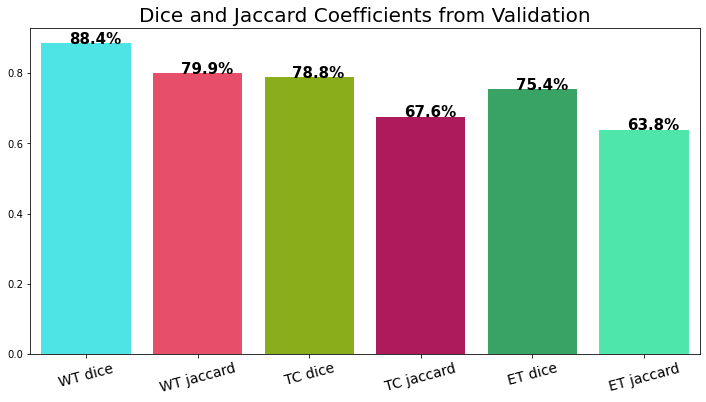

In [28]:
colors = ['#35FCFF', '#FF355A', '#96C503', '#C5035B', '#28B463', '#35FFAF']
palette = sns.color_palette(colors, 6)

fig, ax = plt.subplots(figsize=(12, 6));
sns.barplot(x=val_metics_df.mean().index, y=val_metics_df.mean(), palette=palette, ax=ax);
ax.set_xticklabels(val_metics_df.columns, fontsize=14, rotation=15);
ax.set_title("Dice and Jaccard Coefficients from Validation", fontsize=20)

for idx, p in enumerate(ax.patches):
        percentage = '{:.1f}%'.format(100 * val_metics_df.mean().values[idx])
        x = p.get_x() + p.get_width() / 2 - 0.15
        y = p.get_y() + p.get_height()
        ax.annotate(percentage, (x, y), fontsize=15, fontweight="bold")

fig.savefig("result1.png", format="png",  pad_inches=0.2, transparent=False, bbox_inches='tight')
fig.savefig("result1.svg", format="svg",  pad_inches=0.2, transparent=False, bbox_inches='tight')

## More visualization

In [29]:
def compute_results(model,
                    dataloader,
                    treshold=0.33):
    
    for p in nodel.parameters():
        device = p.device
    results = {"Id": [],"image": [], "GT": [],"Prediction": []}

    with torch.no_grad():
        for i, data in enumerate(dataloader):
            id_, imgs, targets = data['Id'], data['image'], data['mask']
            imgs, targets = imgs.to(device), targets.to(device)
            logits = model(imgs)
            probs = torch.sigmoid(logits)
            
            predictions = (probs >= treshold).float()
            predictions =  predictions.cpu()
            targets = targets.cpu()
            
            results["Id"].append(id_)
            results["image"].append(imgs.cpu())
            results["GT"].append(targets)
            results["Prediction"].append(predictions)
            
            # only 5 pars
            if (i > 5):    
                return results
        return results

In [30]:
%%time
results = compute_results(
    nodel, val_dataloader, 0.33)

CPU times: user 5min 33s, sys: 2min 5s, total: 7min 38s
Wall time: 2min 11s


In [31]:
for id_, img, gt, prediction in zip(results['Id'][4:],
                    results['image'][4:],
                    results['GT'][4:],
                    results['Prediction'][4:]
                    ):
    
    print(id_)
    break

['BraTS20_Training_162']


### convert 3d to 2d ground truth and prediction

In [ ]:
show_result = ShowResult()
show_result.plot(img, gt, prediction)
fig.savefig("result3.png", format="png",  pad_inches=0.2, transparent=False, bbox_inches='tight')

### 3d binary mask projection for ground truth and prediction

ground truth

In [33]:
gt = gt.squeeze().cpu().detach().numpy()
gt = np.moveaxis(gt, (0, 1, 2, 3), (0, 3, 2, 1))
wt,tc, et = gt
print(wt.shape, tc.shape, et.shape)
gt = (wt + tc + et)
gt = np.clip(gt, 0, 1)
print(gt.shape)

(240, 240, 155) (240, 240, 155) (240, 240, 155)
(240, 240, 155)


In [34]:
%%time
title = "Ground Truth_" + id_[0]
filename1 = title + "_3d.gif"

data_to_3dgif = Image3dToGIF3d(img_dim = (120, 120, 78), binary=True, normalizing=False)
transformed_data = data_to_3dgif.get_transformed_data(gt)
data_to_3dgif.plot_cube(
    transformed_data,
    title=title,
    make_gif=True,
    path_to_save=filename1
)
#show_gif(filename1, format='png')

(120, 120, 78)
binary


100%|██████████| 72/72 [09:04<00:00,  7.57s/it]


CPU times: user 11min 26s, sys: 2.94 s, total: 11min 29s
Wall time: 11min 44s


prediction

In [35]:
prediction = prediction.squeeze().cpu().detach().numpy()
prediction = np.moveaxis(prediction, (0, 1, 2, 3), (0, 3, 2, 1))
wt,tc,et = prediction
print(wt.shape, tc.shape, et.shape)
prediction = (wt + tc + et)
prediction = np.clip(prediction, 0, 1)
print(prediction.shape)

(240, 240, 155) (240, 240, 155) (240, 240, 155)
(240, 240, 155)


In [36]:
%%time
title = "Prediction_" + id_[0]
filename2 = title + "_3d.gif"

data_to_3dgif = Image3dToGIF3d(img_dim = (120, 120, 78), binary=True, normalizing=False)
transformed_data = data_to_3dgif.get_transformed_data(prediction)
data_to_3dgif.plot_cube(
    transformed_data,
    title=title,
    make_gif=True,
    path_to_save=filename2
)
#show_gif(filename2, format='png')#

(120, 120, 78)
binary


100%|██████████| 72/72 [09:59<00:00,  8.33s/it]


CPU times: user 12min 20s, sys: 5.54 s, total: 12min 26s
Wall time: 12min 20s


result

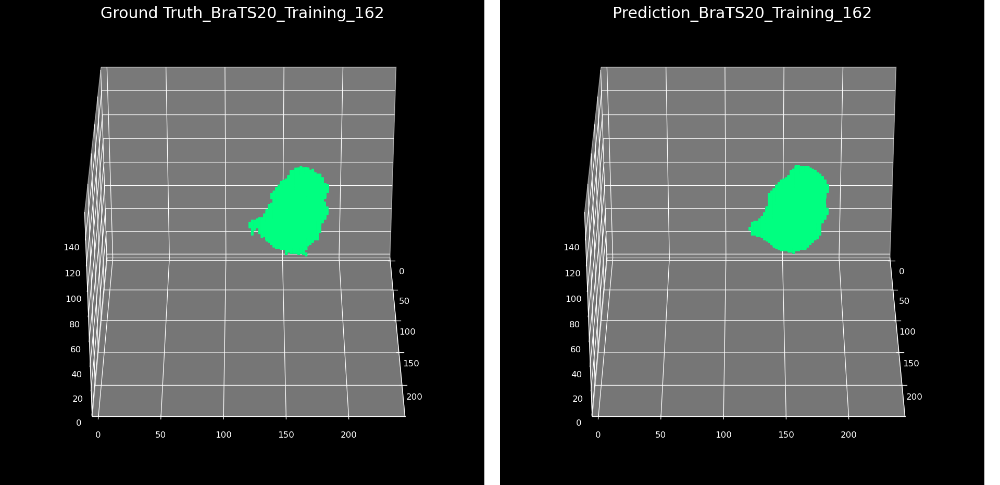

In [37]:
merging_two_gif(filename1,
                filename2, 
                'result.gif')
show_gif('result.gif', format='png')


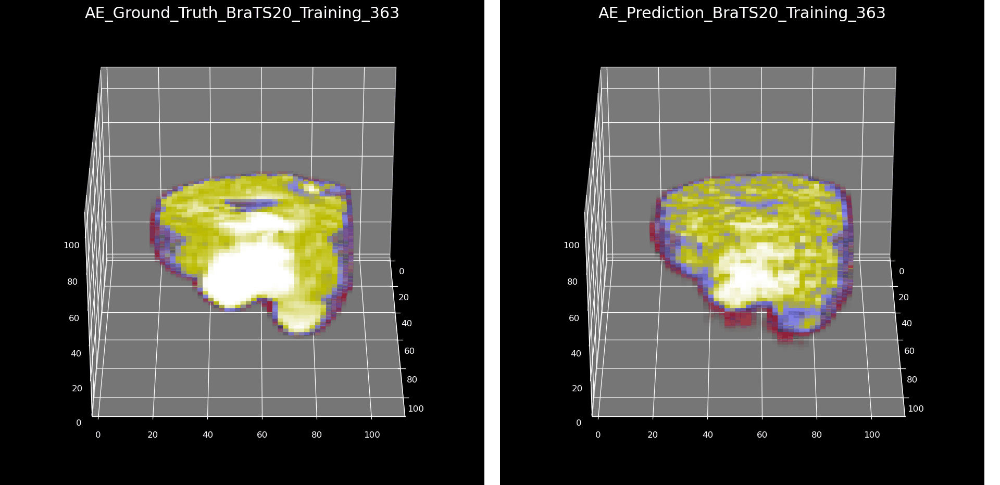

In [53]:
merging_two_gif(filename1,
                filename2, 
                'AE_result.gif')
show_gif('AE_result.gif', format='png')

Now let's generates all latent features

In [56]:
%%time
model.eval();
fg =  Features_Generator(df, model)
fg.run()
fg.df_voxel_stats.to_csv("df_with_voxel_stats_and_latent_features.csv", index=False)
fg.df_voxel_stats

369it [1:34:36, 15.38s/it]


CPU times: user 7min 22s, sys: 1h 22min 15s, total: 1h 29min 38s
Wall time: 1h 34min 37s


,Brats20ID,_t1.nii_skew,_t1.nii_kurtosis,_t1.nii_diff_skew,_t1.nii_intensive_dist,_t1.nii_intensive_skew,_t1.nii_non_intensive_dist,_t1.nii_non_intensive_skew,_t1.nii_data_intensive_skew_difference,_t1.nii_data_non_intensive_skew_difference,...,latent_f504,latent_f505,latent_f506,latent_f507,latent_f508,latent_f509,latent_f510,latent_f511,Age,Survival_days
0,BraTS20_Training_001,2.189105,3.143948,-0.302683,1342282,-0.410911,7585718,114.730576,2.600016,-112.541471,...,0.500319,1.358094,0.274515,-1.944596,0.983427,-1.140537,1.178547,-0.046018,60.463,289
1,BraTS20_Training_002,1.968389,2.200515,0.225981,1538803,-0.403005,7389197,143.749908,2.371394,-141.781520,...,1.493593,1.083624,0.233844,-2.505322,0.980344,-0.675564,1.326785,0.207239,52.263,616
2,BraTS20_Training_003,2.297638,3.615512,1.908453,1261059,-0.654111,7666941,357.393250,2.951749,-355.095611,...,-0.045161,1.479324,0.392099,-1.653651,1.285332,-1.201195,1.296887,-0.086264,54.301,464
3,BraTS20_Training_004,1.953941,2.127259,0.014855,1523029,-0.297262,7404971,292.762421,2.251202,-290.808480,...,1.202072,0.786275,0.277124,-2.045030,1.133743,-0.735318,1.209630,0.210347,39.068,788
4,BraTS20_Training_005,2.105768,2.791831,1.007016,1441603,-0.469777,7486397,192.826630,2.575545,-190.720862,...,0.524493,0.866961,0.169122,-1.129655,0.767136,-0.609370,1.156755,0.037681,68.493,465
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
364,BraTS20_Training_365,2.232847,3.353795,2.639713,1302376,-0.186473,7625624,0.000000,2.419320,2.232847,...,-0.321712,0.754594,0.242423,0.196953,1.341014,-0.742100,1.403548,-0.299132,NaN,NaN
365,BraTS20_Training_366,2.503319,4.466538,-2.969314,1054761,-1.161960,7873239,1984.091309,3.665279,-1981.587990,...,0.509415,0.649370,0.507955,-1.194326,0.120745,-0.609728,1.011100,0.452559,72.000,633
366,BraTS20_Training_367,1.795406,1.509976,0.253106,1696109,-0.426782,7231891,1903.602173,2.222188,-1901.806767,...,1.345389,0.666244,0.249665,-0.776495,0.835285,-0.247828,1.377227,0.034893,60.000,437
367,BraTS20_Training_368,2.150280,2.922769,3.318562,1364050,-0.701649,7563950,192.933716,2.851929,-190.783436,...,0.444608,1.051457,0.327110,-1.836949,0.949285,-0.381606,1.160479,0.013101,49.000,442


Now that we have tabular data, we can use it to predict age and survival days.
we will use SVR for this purpose.

In [57]:
df = pd.read_csv("df_with_voxel_stats_and_latent_features.csv")#

df['is_train'] = 0
df['is_train'].loc[df['Survival_days'].notnull()] = 1

df['SD'] = df['Survival_days'].str.extract(r'(\d+[.\d]*)')
df['SD'] = df['SD'].astype("float64")
df['Age'] = df['Age'].astype("float64")
df.sample(5)

,Brats20ID,_t1.nii_skew,_t1.nii_kurtosis,_t1.nii_diff_skew,_t1.nii_intensive_dist,_t1.nii_intensive_skew,_t1.nii_non_intensive_dist,_t1.nii_non_intensive_skew,_t1.nii_data_intensive_skew_difference,_t1.nii_data_non_intensive_skew_difference,...,latent_f506,latent_f507,latent_f508,latent_f509,latent_f510,latent_f511,Age,Survival_days,is_train,SD
26,BraTS20_Training_027,2.098337,2.764123,0.666092,1444946,-0.458542,7483054,181.937714,2.556879,-179.839377,...,0.231431,-1.915354,1.120564,-0.828096,1.386364,0.143257,60.063,336,1,336.0
258,BraTS20_Training_259,2.406896,4.073100,1.668693,1121278,-0.537155,7806722,49.483894,2.944051,-47.076998,...,0.320737,-0.876658,0.517754,-0.435610,1.021529,0.012797,NaN,NaN,0,NaN
128,BraTS20_Training_129,2.109435,2.888981,0.137763,1517170,-0.390017,7410830,98.201012,2.499452,-96.091577,...,0.106385,-0.352492,0.635411,-0.197103,1.083864,-0.036526,67.677,692,1,692.0
126,BraTS20_Training_127,2.094657,2.797074,0.694697,1508539,-0.397532,7419461,152.249969,2.492189,-150.155313,...,0.183702,-0.574877,0.803515,-0.481779,1.075755,-0.051695,64.808,374,1,374.0
6,BraTS20_Training_007,2.234219,3.466654,2.201798,1377389,-0.277901,7550611,178.572342,2.512120,-176.338123,...,0.158680,-1.453820,0.954396,-0.808325,1.264722,-0.001047,69.912,503,1,503.0


In [58]:
test_df = df[df["is_train"] != True].copy()
df = df[df["is_train"] == True].copy()
print("train ->", df.shape, "test ->", test_df.shape)

train -> (236, 617) test -> (133, 617)


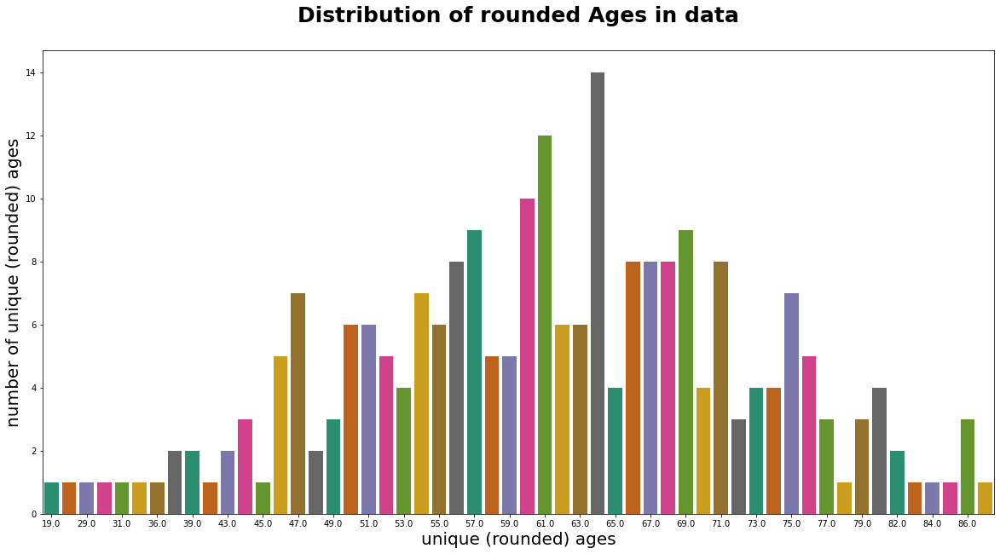

In [59]:
fig, ax = plt.subplots(figsize=(20, 10))
sns.countplot(df['Age'].apply(lambda x: np.round(x, 0)), ax=ax, palette='Dark2')

ax.set_xticks(ax.get_xticks()[::2]);
ax.set_ylabel('number of unique (rounded) ages', fontsize=20)
ax.set_xlabel('unique (rounded) ages', fontsize=20)
ax.set_title("Distribution of rounded Ages in data", fontsize=25, y=1.05, fontweight='bold');

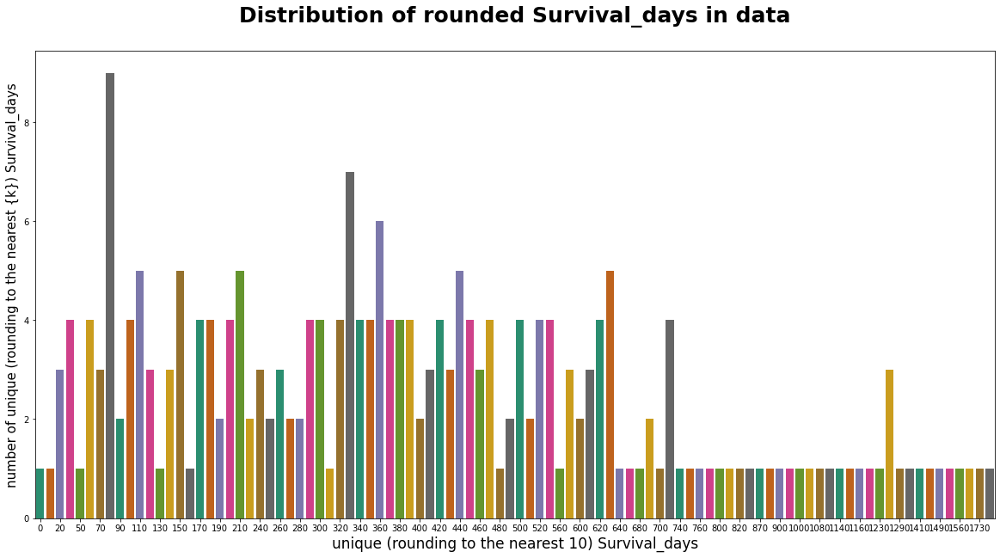

In [60]:
fig, ax = plt.subplots(figsize=(20, 10))
k = 10
sns.countplot(df['SD'].apply(lambda x: int(k * round(float(x)/k))), ax=ax, palette='Dark2')#base * round(float(x)/base)

ax.set_xticks(ax.get_xticks()[::2]);
ax.set_ylabel('number of unique (rounding to the nearest {k}) Survival_days', fontsize=15)
ax.set_xlabel(f'unique (rounding to the nearest {k}) Survival_days', fontsize=17)
ax.set_title("Distribution of rounded Survival_days in data", fontsize=25, y=1.05, fontweight='bold');

In [61]:
def metric(y_true, y_pred):
    return np.mean(np.sum(np.abs(y_true - y_pred), axis=0)/np.sum(y_true, axis=0))

In [62]:
%%time
NUM_FOLDS = 7
kf = KFold(n_splits=NUM_FOLDS, shuffle=True, random_state=config.seed)


features = list(df.columns[1:-4])

overal_score = 0
for target, c, w in [("Age", 100, 0.5), ("SD", 5, 0.5)]:    
    y_oof = np.zeros(df.shape[0])
    y_test = np.zeros((test_df.shape[0], NUM_FOLDS))
    
    for f, (train_ind, val_ind) in enumerate(kf.split(df, df)):
        train_df, val_df = df.iloc[train_ind], df.iloc[val_ind]
        train_df = train_df[train_df[target].notnull()]

        model = SVR(C=c, cache_size=3000.0)
        model.fit(train_df[features], train_df[target])

        y_oof[val_ind] = model.predict(val_df[features])
        y_test[:, f] = model.predict(test_df[features])
        
    df["pred_{}".format(target)] = y_oof
    test_df[target] = y_test.mean(axis=1)
    score = metric(df[df[target].notnull()][target].values, df[df[target].notnull()]["pred_{}".format(target)].values)
    overal_score += w*score
    print(target, np.round(score, 4))
    print()
    
print("Overal score:", np.round(overal_score, 4))

Age 0.1491

SD 0.5628

Overal score: 0.3559
CPU times: user 394 ms, sys: 0 ns, total: 394 ms
Wall time: 738 ms
